# CAR PREDICTOR

<table align="left">
  <td>
    <a target="_blank" href="https://colab.research.google.com/github/georgia-tech-db/eva/blob/master/tutorials/03-emotion-analysis.ipynb"><img src="https://www.tensorflow.org/images/colab_logo_32px.png" /> Run on Google Colab</a>
  </td>
  <td>
    <a target="_blank" href="https://github.com/georgia-tech-db/eva/blob/master/tutorials/03-emotion-analysis.ipynb"><img src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" /> View source on GitHub</a>
  </td>
  <td>
    <a target="_blank" href="https://raw.githubusercontent.com/georgia-tech-db/eva/master/tutorials/03-emotion-analysis.ipynb"><img src="https://www.tensorflow.org/images/download_logo_32px.png" /> Download notebook</a>
  </td>
</table>

### Start EVA Server
We are reusing the start server notebook for launching the EVA server

In [1]:
def connect_to_server():
    from eva.server.db_api import connect
    %pip install nest_asyncio --quiet
    import nest_asyncio
    nest_asyncio.apply()

    # Connect client with server
    connection = connect(host = '127.0.0.1', port = 5432) 
    cursor = connection.cursor()

    return cursor

cursor = connect_to_server()

Note: you may need to restart the kernel to use updated packages.


### Video Files
getting some video files to test

In [3]:
# Test videos from the BDD dataset (https://bdd-data.berkeley.edu/)
!wget -nc https://www.dropbox.com/s/xdn0i7o3oq0rq7k/bddtest_3.mp4
!wget -nc https://www.dropbox.com/s/xv44iy2a2rg1zgq/bddtest_4.mp4

File ‘bddtest_3.mp4’ already there; not retrieving.

--2023-01-21 15:25:46--  https://www.dropbox.com/s/xv44iy2a2rg1zgq/bddtest_4.mp4
Resolving www.dropbox.com (www.dropbox.com)... 162.125.9.18, 2620:100:601f:18::a27d:912
Connecting to www.dropbox.com (www.dropbox.com)|162.125.9.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/xv44iy2a2rg1zgq/bddtest_4.mp4 [following]
--2023-01-21 15:25:46--  https://www.dropbox.com/s/raw/xv44iy2a2rg1zgq/bddtest_4.mp4
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucd967d1e7c7d88daff296c62a48.dl.dropboxusercontent.com/cd/0/inline/B1BB-W17fnPyQi7pZLVrJ4jOg-wMYf0PQJu05JA2nCGjZId15T3YTbEytpKNh2-0DoNatHLlSkIvqHkN6p9tc1gjArXPiLTK4NteIRjObb_yZcyrNhCnMl2FDwIlVTk6wfhrPn-HDTiB-YaBY0nJIA6jzWP3B5OHiY-LJ6ghtpJkNw/file# [following]
--2023-01-21 15:25:46--  https://ucd967d1e7c7d88daff296c62a48.dl.dropboxusercontent.com/cd/0/inline/B1BB-W17fnPyQi7pZLVrJ4jO

### Adding the video file to EVADB for analysis

In [4]:
cursor.execute('DROP TABLE bddtest_4')
response = cursor.fetch_all()
print(response)
cursor.execute('LOAD VIDEO "./tutorials/bddtest_4.mp4" INTO bddtest_4')
response = cursor.fetch_all()
print(response)

@status: ResponseStatus.FAIL
@batch: 
 None
@error: Table: bddtest_4 does not exist
@status: ResponseStatus.SUCCESS
@batch: 
                            0
0  Number of loaded VIDEO: 1
@query_time: 0.05167203699966194


### Visualize Video

In [5]:
from IPython.display import Video
Video("bddtest_4.mp4", height=450, width=800, embed=True)

### Create an user-defined function(UDF) for car detector and car predictor

In [6]:
cursor.execute("""CREATE UDF IF NOT EXISTS CarPredictor 
        INPUT (frame NDARRAY UINT8(3, ANYDIM, ANYDIM)) 
        OUTPUT (labels NDARRAY STR(ANYDIM), scores NDARRAY FLOAT32(ANYDIM)) 
        TYPE  Classification IMPL './eva/udfs/car_predictor.py';
        """)
response = cursor.fetch_all()
print(response)
cursor.execute("""CREATE UDF IF NOT EXISTS CarDetector
                  INPUT  (frame NDARRAY UINT8(3, ANYDIM, ANYDIM))
                  OUTPUT (bboxes NDARRAY FLOAT32(ANYDIM, 4),
                          scores NDARRAY FLOAT32(ANYDIM))
                  TYPE  Classification
                  IMPL  './eva/udfs/car_detector.py';
        """)
response = cursor.fetch_all()
print(response)

@status: ResponseStatus.SUCCESS
@batch: 
                                                  0
0  UDF CarPredictor already exists, nothing added.
@query_time: 0.006056552003428806
@status: ResponseStatus.SUCCESS
@batch: 
                                                 0
0  UDF CarDetector already exists, nothing added.
@query_time: 0.005325949998223223


### Run the Car Detection UDF on video 

In [7]:
cursor.execute("""SELECT id, CarDetector(data)
                  FROM bddtest_4 WHERE id<50;""")
response = cursor.fetch_all()
print(response)

@status: ResponseStatus.SUCCESS
@batch: 
     bddtest_4.id  \
0              0   
1              1   
2              2   
3              3   
4              4   
5              5   
6              6   
7              7   
8              8   
9              9   
10            10   
11            11   
12            12   
13            13   
14            14   
15            15   
16            16   
17            17   
18            18   
19            19   
20            20   
21            21   
22            22   
23            23   
24            24   
25            25   
26            26   
27            27   
28            28   
29            29   
30            30   
31            31   
32            32   
33            33   
34            34   
35            35   
36            36   
37            37   
38            38   
39            39   
40            40   
41            41   
42            42   
43            43   
44            44   
45            45   
46            46  

### Run the Emotion Detection UDF on the outputs of the Face Detection UDF

In [15]:
cursor.execute("""SELECT id, bbox, CarPredictor(Crop(data, bbox)) 
                  FROM bddtest_4 JOIN LATERAL UNNEST(CarDetector(data)) AS Car(bbox, conf) WHERE id<50;""")
response = cursor.fetch_all()
print(response)

@status: ResponseStatus.SUCCESS
@batch: 
      bddtest_4.id                                      Car.bbox  \
0               0  [468.75974, 339.35883, 737.76434, 559.17175]   
1               0   [892.06525, 338.05222, 935.26196, 412.4882]   
2               0   [987.8213, 316.30774, 1171.9344, 439.48206]   
3               1     [468.2486, 342.69666, 742.573, 565.32086]   
4               1    [889.51843, 336.8733, 935.8964, 412.24115]   
..            ...                                           ...   
152            48     [899.5779, 309.11072, 1276.409, 540.6463]   
153            48   [733.5062, 324.56287, 897.39026, 440.16736]   
154            49    [364.17838, 331.9395, 777.1574, 658.13214]   
155            49     [894.6627, 311.61963, 1277.482, 539.2641]   
156            49    [736.0349, 322.45242, 895.7611, 440.88364]   

    carpredictor.labels  carpredictor.scores  
0           mini_cooper             0.372817  
1         gmc_yukon1500             0.567503  
2      honda

In [18]:
import cv2
from pprint import pprint
from matplotlib import pyplot as plt

def annotate_video(detections, input_video_path, output_video_path):
    color1=(207, 248, 64)
    color2=(255, 49, 49)
    thickness=2

    vcap = cv2.VideoCapture(input_video_path)
    width = int(vcap.get(3))
    height = int(vcap.get(4))
    fps = vcap.get(5)
    fourcc = cv2.VideoWriter_fourcc('m', 'p', '4', 'v') #codec
    video=cv2.VideoWriter(output_video_path, fourcc, fps, (width,height))

    frame_id = 0
    # Capture frame-by-frame
    # ret = 1 if the video is captured; frame is the image
    ret, frame = vcap.read() 

    while ret:
        df = detections
        df = df[['Car.bbox', 'carpredictor.labels', 'carpredictor.scores']][df['bddtest_4.id'] == frame_id]
        if df.size:
            
            dfLst = df.values.tolist()
            #print(f"df: {df}")
            #print(f"dfLst: {dfLst} size: {len(dfLst)}")
            
            for entry in dfLst:
                #print(f"entry: {entry}")
                bbox = entry[0]
                label = entry[1]
                score = entry[2]
                x1, y1, x2, y2 = bbox
                x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)
                # object bbox
                frame=cv2.rectangle(frame, (x1, y1), (x2, y2), color1, thickness) 
                # object label
                cv2.putText(frame, label, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color1, thickness) 
                # frame label
                cv2.putText(frame, 'Frame ID: ' + str(frame_id), (700, 500), cv2.FONT_HERSHEY_SIMPLEX, 1.2, color2, thickness)
        video.write(frame)
        
        # Stop after twenty frames (id < 20 in previous query)
        if frame_id == 50:
            break
            
        # Show every fifth frame
        if frame_id % 5 == 0:
            plt.imshow(frame)
            plt.show()
        
        
        frame_id+=1
        ret, frame = vcap.read()

    video.release()
    vcap.release()

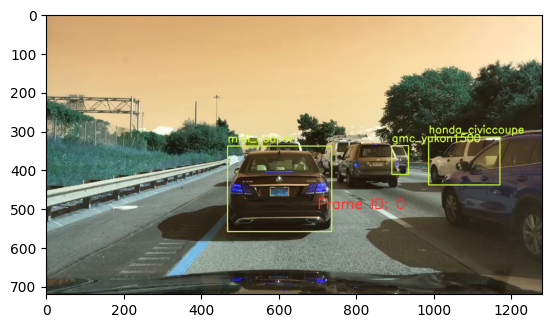

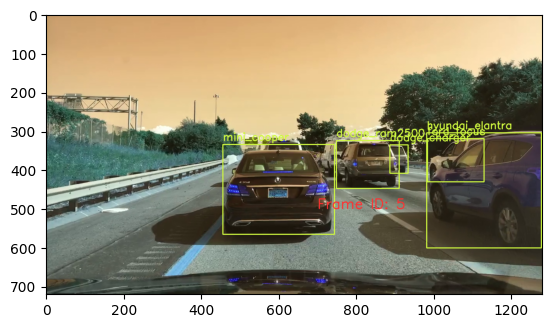

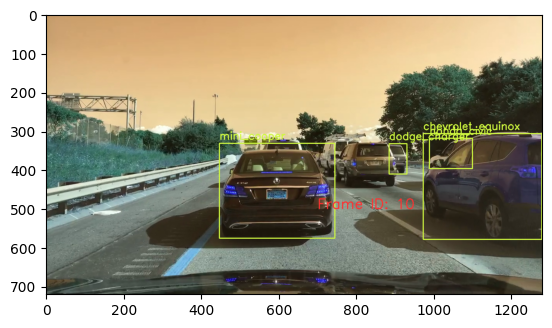

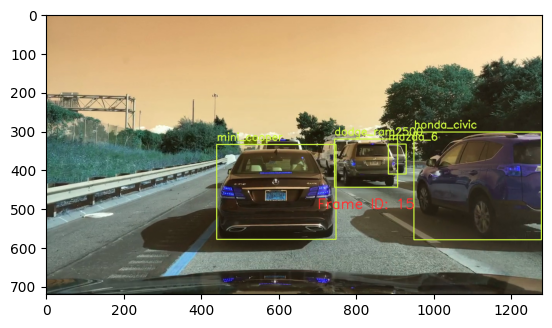

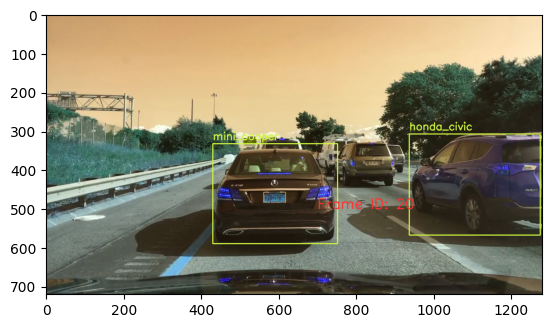

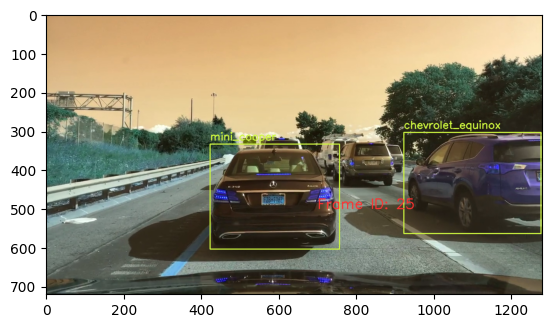

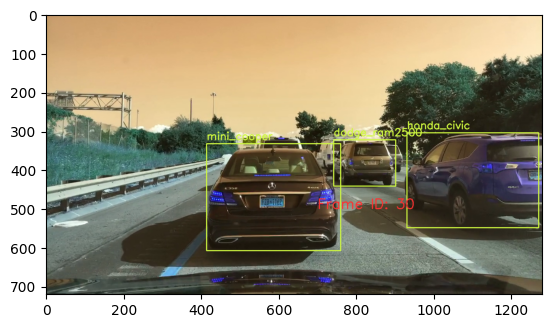

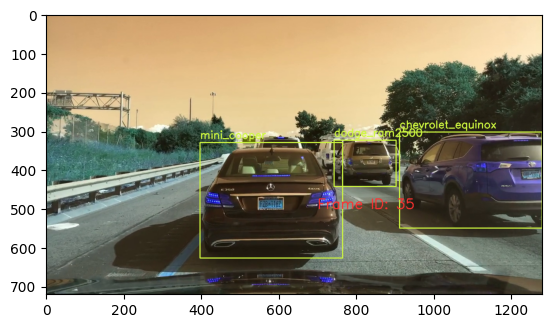

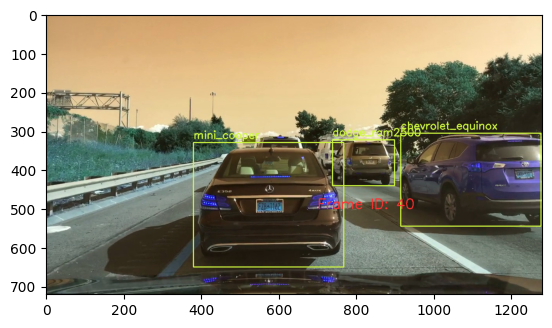

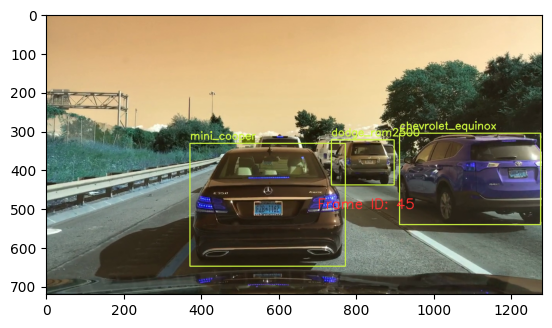

In [19]:
from ipywidgets import Video, Image
input_path = 'bddtest_4.mp4'
output_path = 'bddtest_4_output.mp4'

dataframe = response.batch.frames
annotate_video(dataframe, input_path, output_path)